In [1]:
#!pip install ipynb-path
import ipynb_path
import sys 
import os
__file__ = ipynb_path.get()
sys.path.append(os.path.abspath(os.path.join(os.path.dirname(__file__), '..','dbittools','Analysis','Python','read_dbit')))
import read_dbit
import numpy as np
import scanpy as sc
import squidpy as sq
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
datadir = os.path.abspath(os.path.join(os.path.dirname(__file__), '..','..','..','data','processed','A22-1650_ONH_01'))

In [3]:
# Must include a library_id name (for plotting below)
adata = read_dbit.read_dbit(path=datadir, count_file='count_file.tsv', library_id="ONH1650_1", load_images=True)
adata.uns['spatial']['ONH1650_1']['scalefactors']['tissue_lowres_scalef'] = 0.725
adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['spot_diameter_real_um'] = 25

/home/mdistasio/Dropbox/Yale/DiStasioLab/OpticNerveHead_DBiT/data/processed/A22-1650_ONH_01/spatial/intersections_matx.txt
/home/mdistasio/Dropbox/Yale/DiStasioLab/OpticNerveHead_DBiT/data/processed/A22-1650_ONH_01/spatial/tissue_positions_list.csv
None
Using intersections_matx.txt


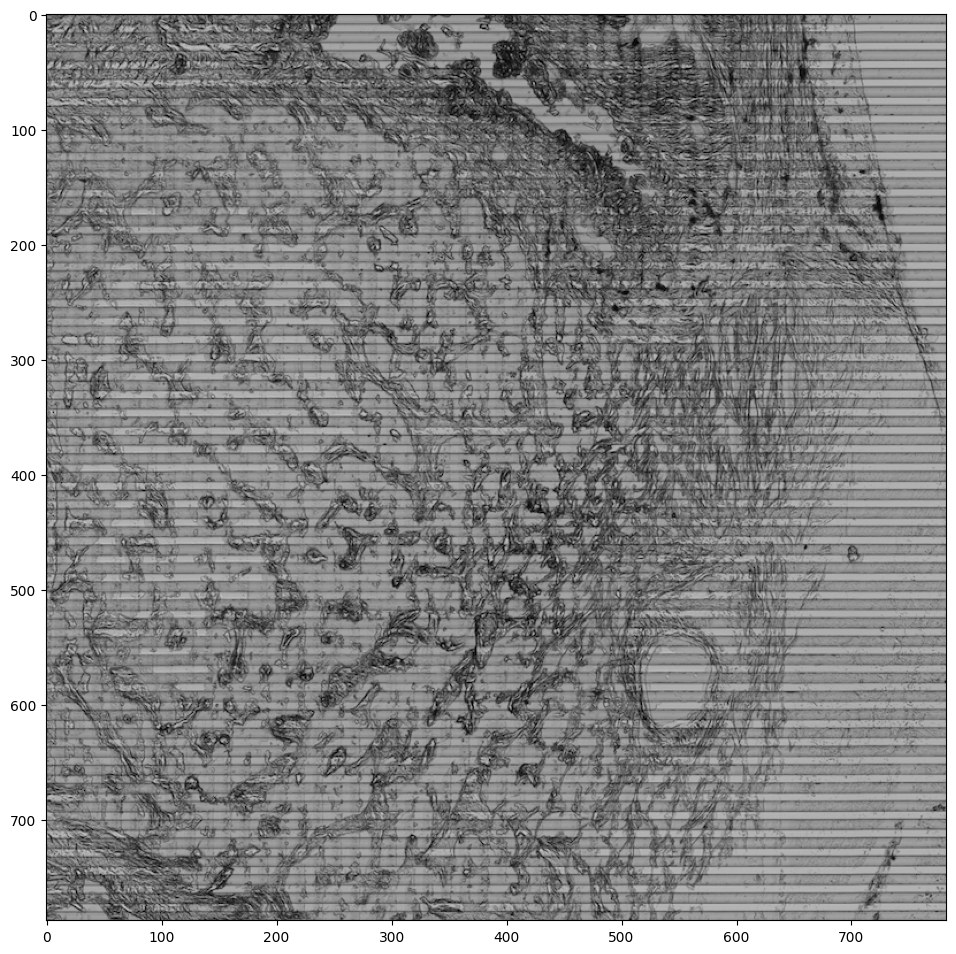

In [4]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 
plt.imshow(adata.uns['spatial']['ONH1650_1']['images']['lowres'])

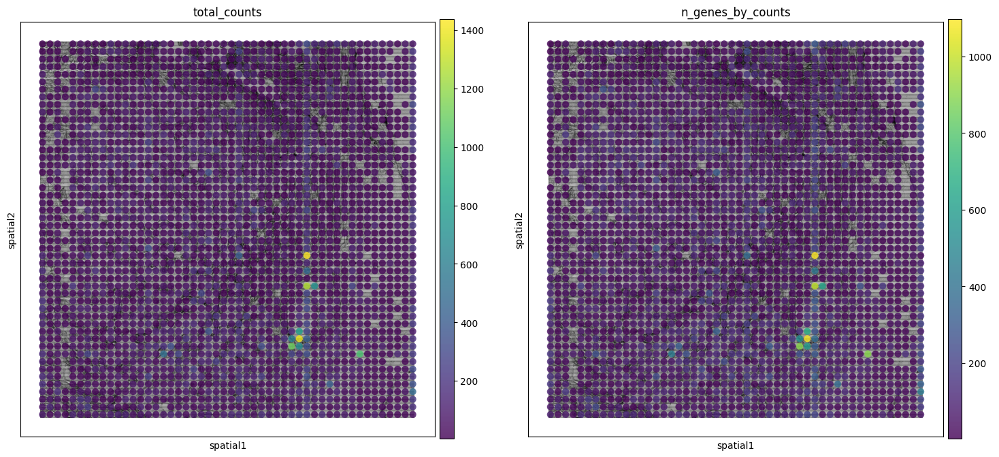

/home/mdistasio/miniconda3/envs/dbitseq3/lib/python3.7/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='n_genes_by_counts'>

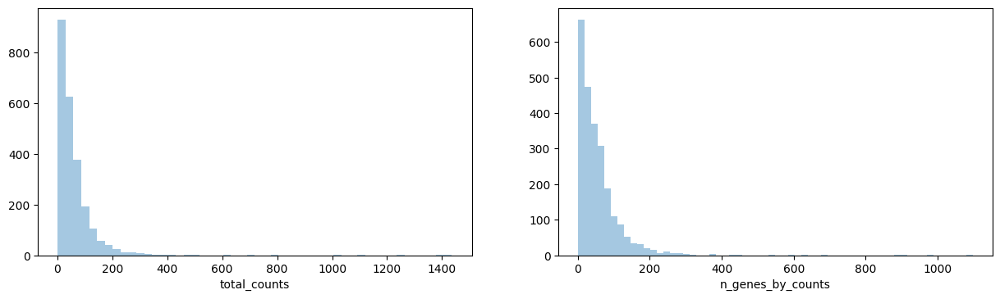

In [5]:

sc.pp.calculate_qc_metrics(adata, inplace=True)
plt.rcParams["figure.figsize"] = (8, 8)
# sc.pl.spatial(adata, img=adata.uns['spatial'][None]['images']['lowres'], 
#               color=["total_counts", "n_genes_by_counts"], spot_size=20, alpha=0.5, scale_factor=1.65)
sc.pl.spatial(adata, img_key="lowres", color=["total_counts", "n_genes_by_counts"], spot_size=20, alpha=0.8)

fig, axs = plt.subplots(1, 2, figsize=(15, 4))
sns.distplot(adata.obs["total_counts"], kde=False, ax=axs[0])
sns.distplot(adata.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[1])


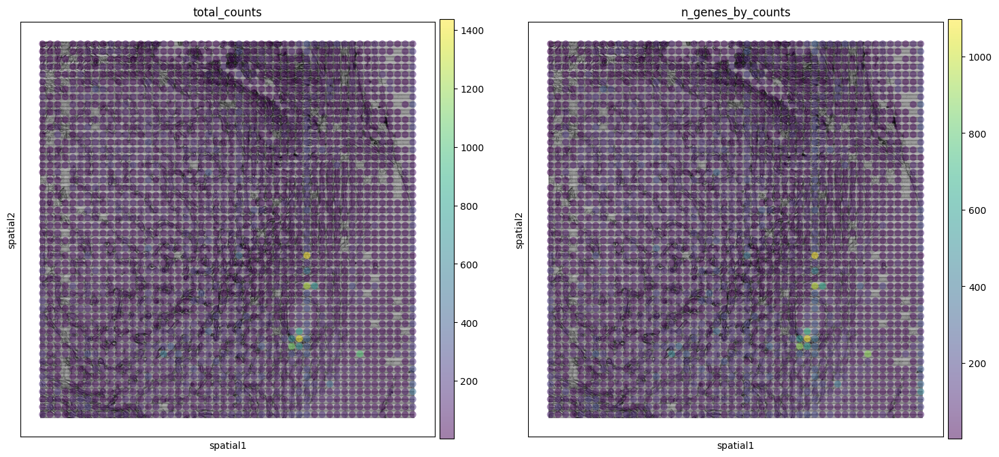

In [6]:
sc.pl.spatial(adata, img_key='lowres', color=["total_counts", "n_genes_by_counts"], spot_size=20, alpha=0.5)

In [7]:
sc.pp.filter_cells(adata, min_counts=10)
sc.pp.filter_cells(adata, max_counts=1500)
sc.pp.filter_genes(adata, min_cells=2)

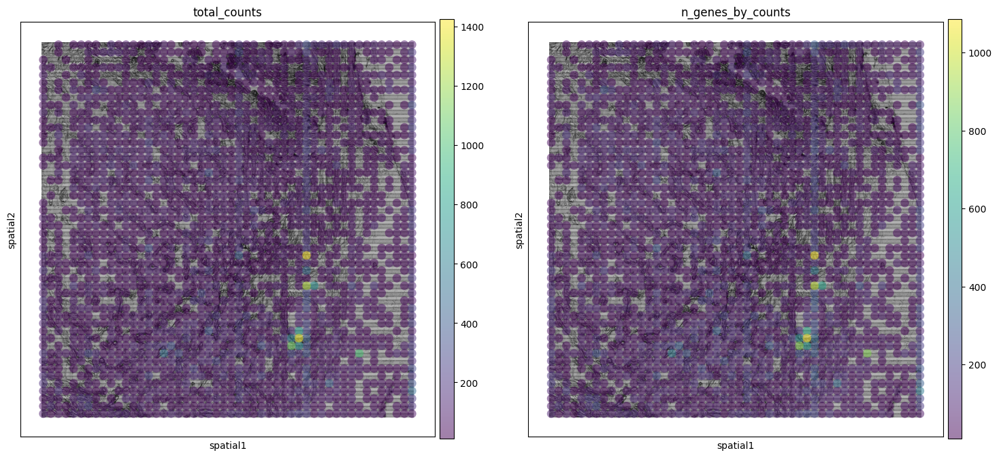

In [8]:
sc.pp.calculate_qc_metrics(adata, inplace=True)
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(adata, img_key="lowres", color=["total_counts", "n_genes_by_counts"], spot_size=25, alpha=0.5)

In [9]:
# MAGIC
import magic
import scprep
magic_operator = magic.MAGIC()

#onh = adata.to_df()

onhn = scprep.normalize.library_size_normalize(adata.to_df())
onh_magic = magic_operator.fit_transform(onhn, genes='all_genes')

adatam = adata.copy()
adatam.X = onh_magic

Calculating MAGIC...
  Running MAGIC on 2048 cells and 4033 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 1.09 seconds.
    Calculating KNN search...
    Calculated KNN search in 0.37 seconds.
    Calculating affinities...
    Calculated affinities in 0.36 seconds.
  Calculated graph and diffusion operator in 1.83 seconds.
  Calculating imputation...
  Calculated imputation in 0.31 seconds.
Calculated MAGIC in 2.17 seconds.


In [10]:
import phate
data_phate = phate.PHATE().fit_transform(adata)



Calculating PHATE...
  Running PHATE on 2048 observations and 4033 variables.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 2.14 seconds.
    Calculating KNN search...
    Calculated KNN search in 0.40 seconds.
    Calculating affinities...
    Calculated affinities in 0.24 seconds.
  Calculated graph and diffusion operator in 2.79 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 0.78 seconds.
    Calculating KMeans...
    Calculated KMeans in 10.93 seconds.
  Calculated landmark operator in 12.50 seconds.
  Calculating optimal t...
    Automatically selected t = 6
  Calculated optimal t in 2.35 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.27 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 2.50 seconds.
Calculated PHATE in 20.42 seconds.


<AxesSubplot:xlabel='PHATE1', ylabel='PHATE2'>

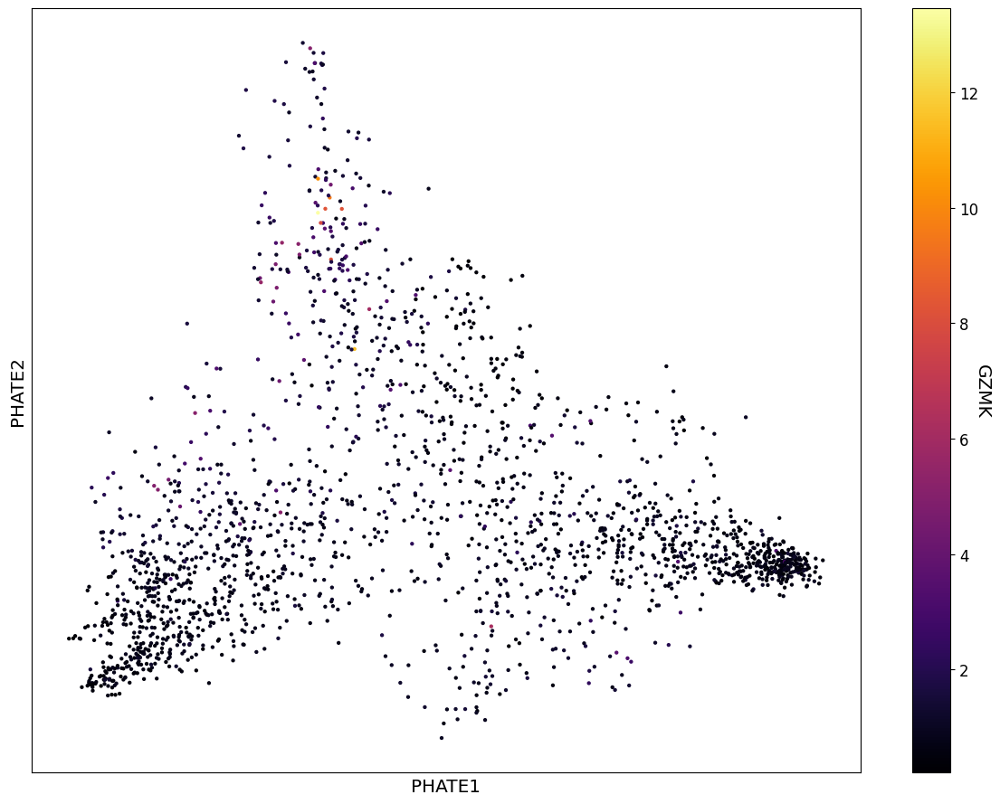

In [11]:
scprep.plot.scatter2d(data_phate, c=adatam.to_df()['GZMK'], figsize=(12,9),
                      ticks=False, label_prefix="PHATE", legend_title="GZMK")

In [12]:
adatam.to_df()['FLT1']

16x15    3.556616
45x40    4.526867
31x7     6.690197
10x1     5.357006
5x28     4.547815
           ...   
6x43     3.808137
32x19    3.025242
38x11    5.816492
18x40    3.445798
37x4     3.756809
Name: FLT1, Length: 2048, dtype: float64

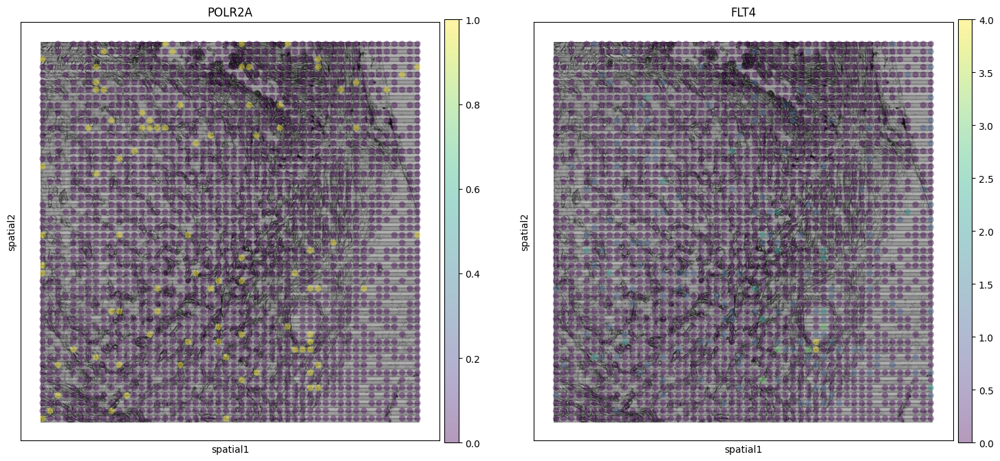

In [13]:
sc.pl.spatial(adata, img_key="lowres", color=["POLR2A","FLT4"], spot_size=18, alpha=0.4)

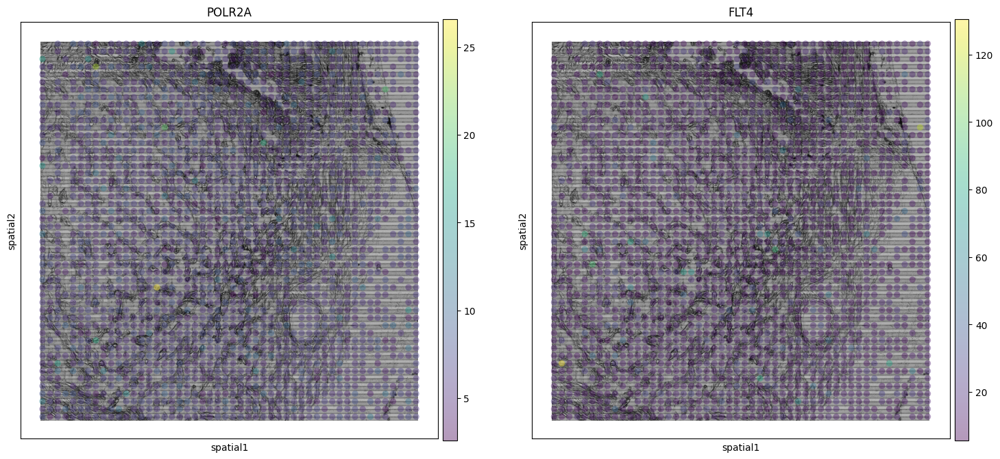

In [14]:
sc.pl.spatial(adatam, img_key="lowres", color=["POLR2A","FLT4"], spot_size=18, alpha=0.4)

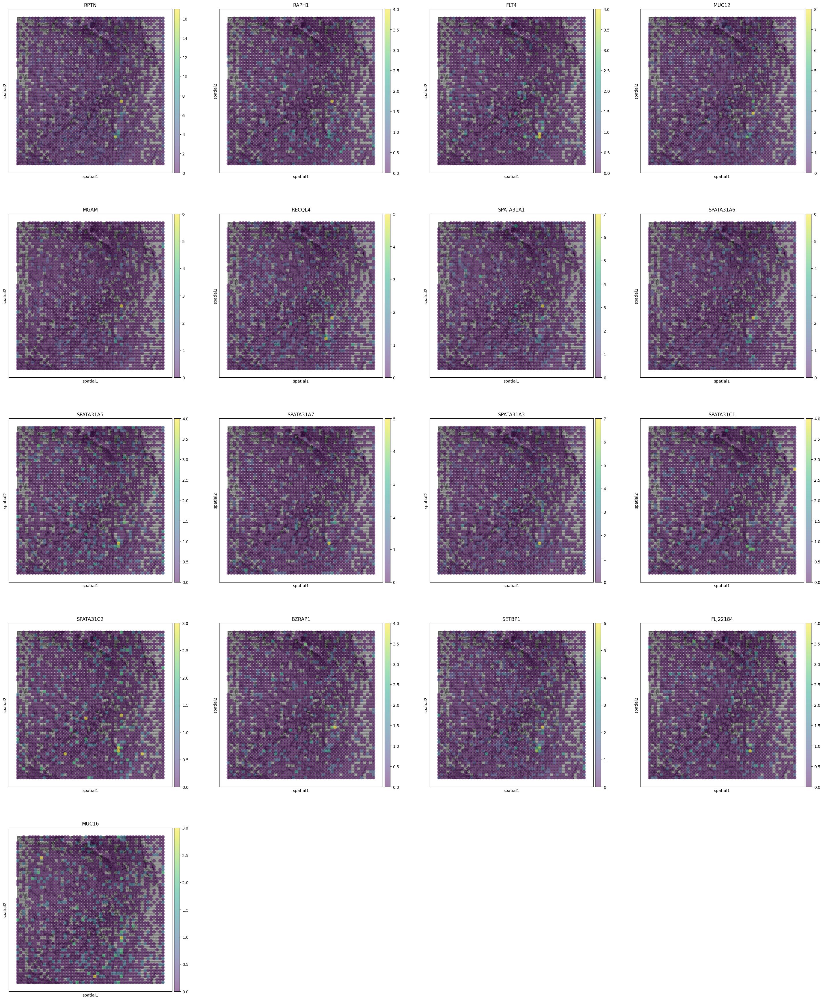

In [15]:
adata_filt = sc.pp.filter_genes(adata, min_counts=220, min_cells=None, max_counts=None, max_cells=None, inplace=False)
mygenes = adata.var_names[adata_filt[0]]
sc.pl.spatial(adata, img_key="lowres", color=mygenes, spot_size=25, alpha=0.5)

In [16]:
sc.pp.pca(adatam)
sc.pp.neighbors(adatam)
sc.tl.umap(adatam)
#sc.tl.louvain(adatam, key_added="cluster_louvain", resolution=0.58)
sc.tl.louvain(adatam, key_added="cluster_louvain", resolution=1)




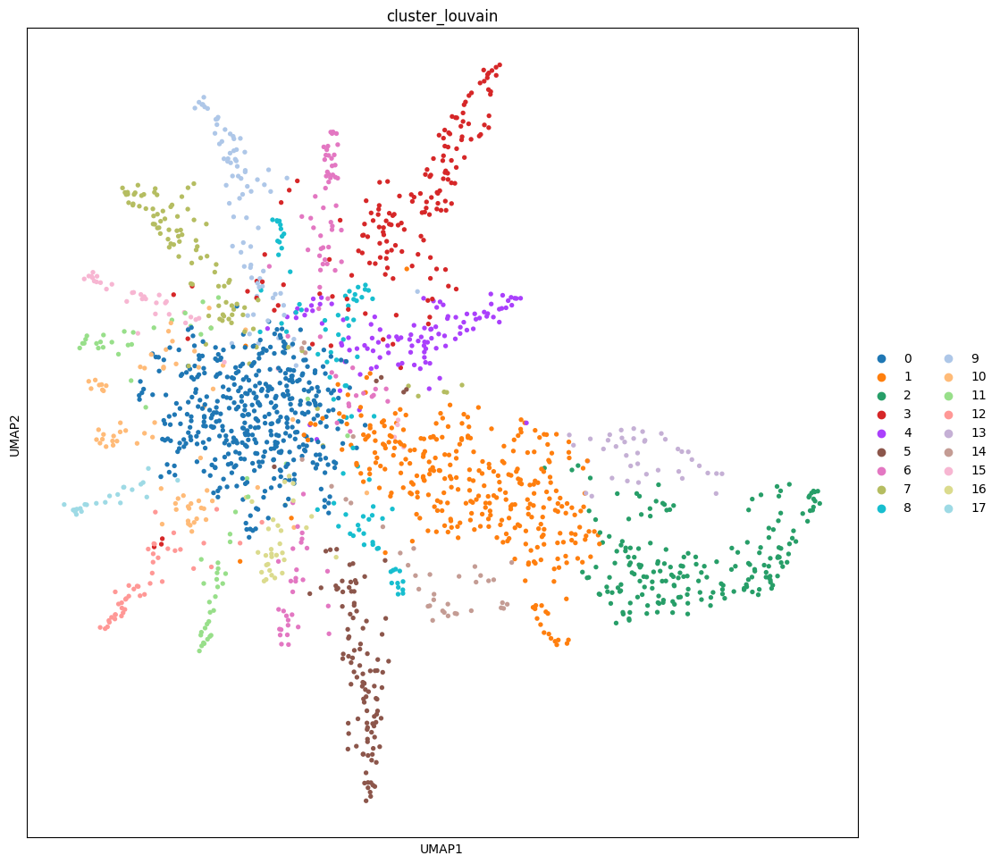

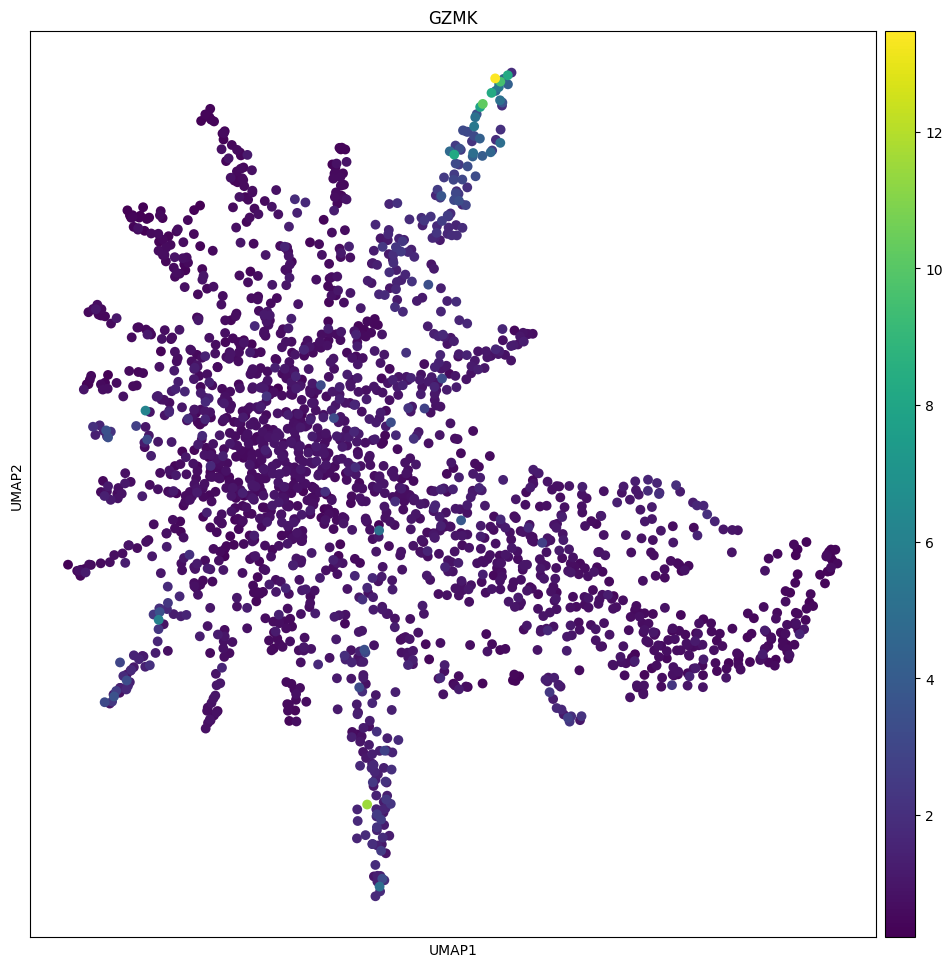

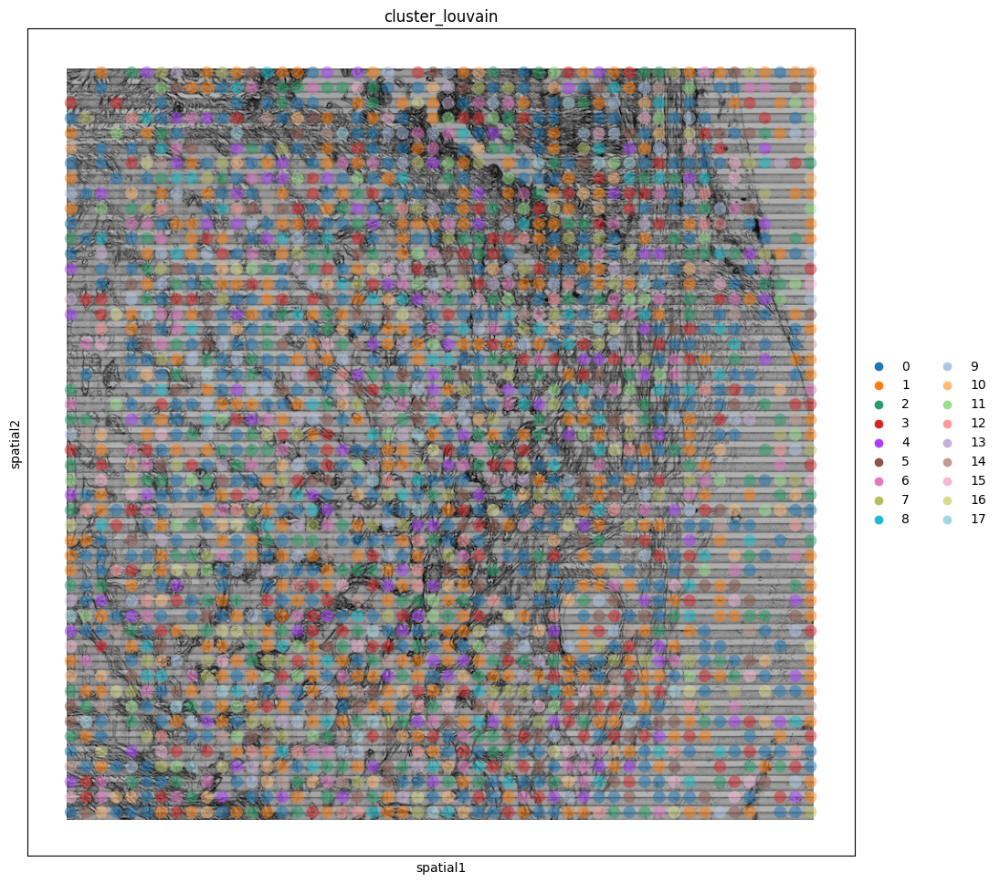

In [17]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 
#sc.pl.umap(adatam, color=["total_counts", "n_genes_by_counts", "clusters"], wspace=0.4)
sc.pl.umap(adatam, color=["cluster_louvain"])
sc.pl.umap(adatam, color=["GZMK"], size=200)
sc.pl.spatial(adatam, img_key="lowres", color="cluster_louvain", spot_size=18, alpha=0.5)

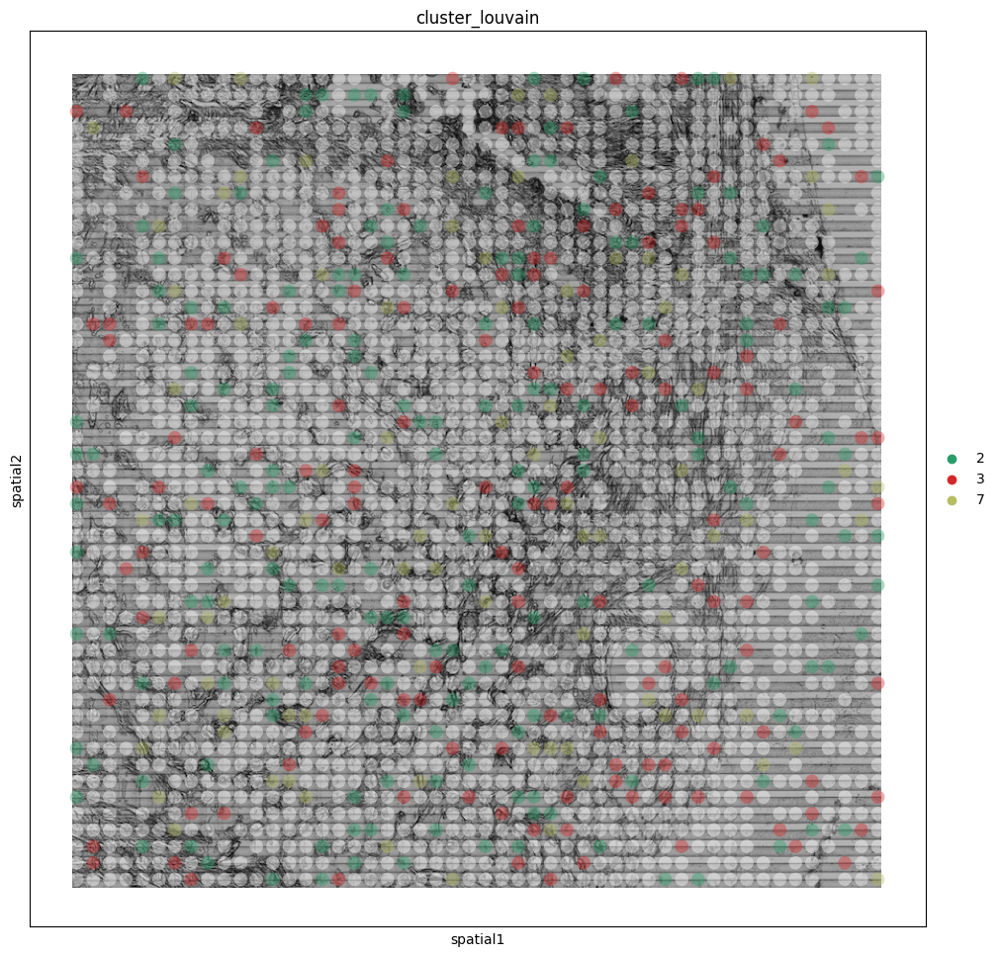

In [49]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 
sc.pl.spatial(adatam, img_key="lowres", color="cluster_louvain", spot_size=18, na_color='white', na_in_legend=False, alpha=0.4, groups=["2","7"])

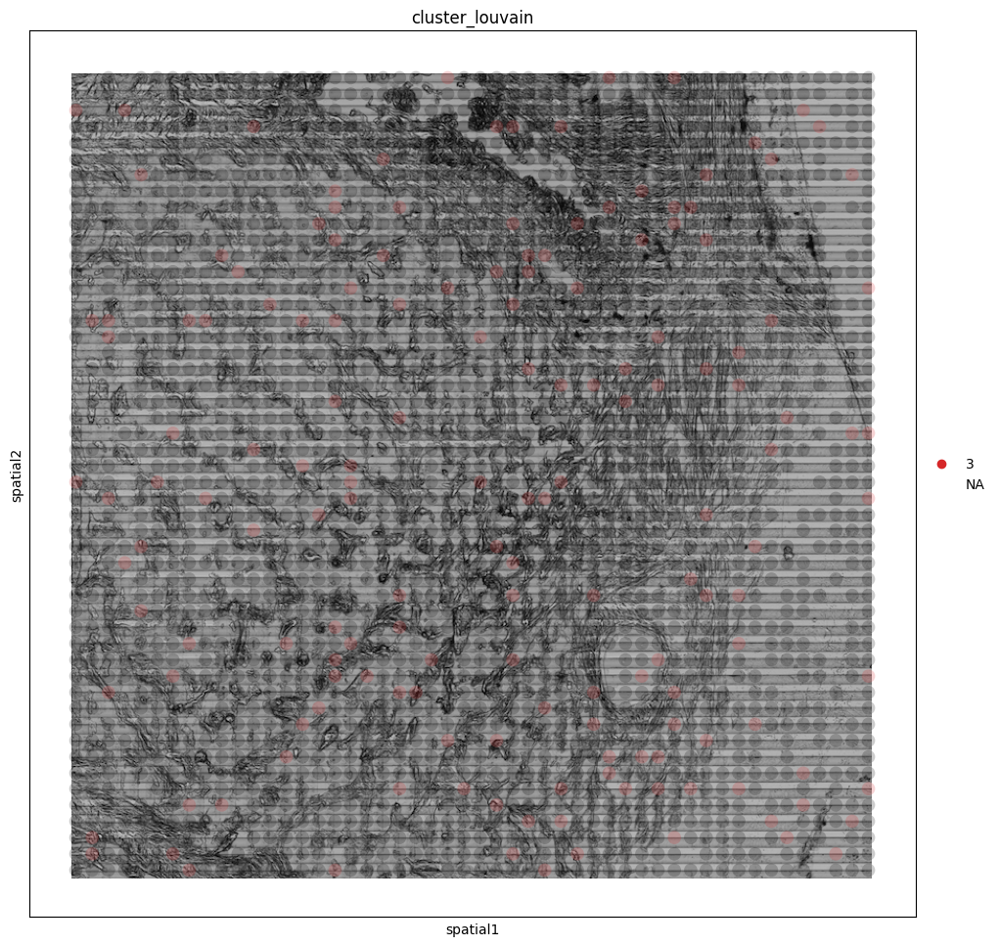

In [50]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 
sc.pl.spatial(adatam, img_key="lowres", color="cluster_louvain", spot_size=18, alpha=0.2, groups=["3"])

categories: 0, 1, 2, etc.
var_group_labels: Neuron, Other, T-cell


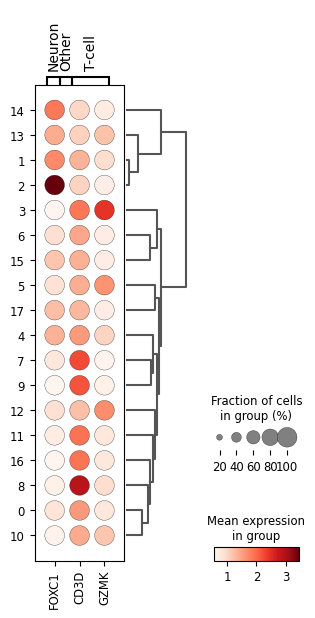

In [19]:
marker_genes_dict = {
    'Neuron': ['FOXC1'],
    'Other': [],
    'T-cell': ['CD3D',"GZMK"],
}

sc.tl.dendrogram(adatam, groupby='cluster_louvain')

sc.pl.dotplot(adatam, marker_genes_dict, 'cluster_louvain', dendrogram=True)

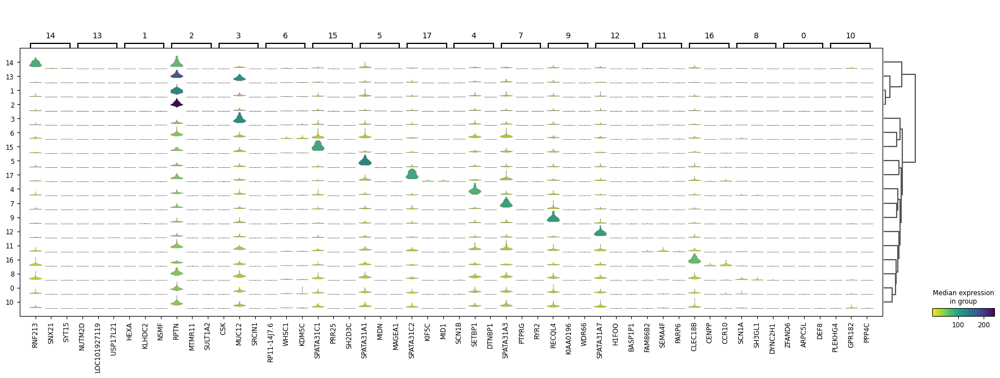

In [35]:

sc.tl.rank_genes_groups(adatam, groupby='cluster_louvain', method='wilcoxon')
sc.pl.rank_genes_groups_stacked_violin(adatam, n_genes=3, cmap='viridis_r')

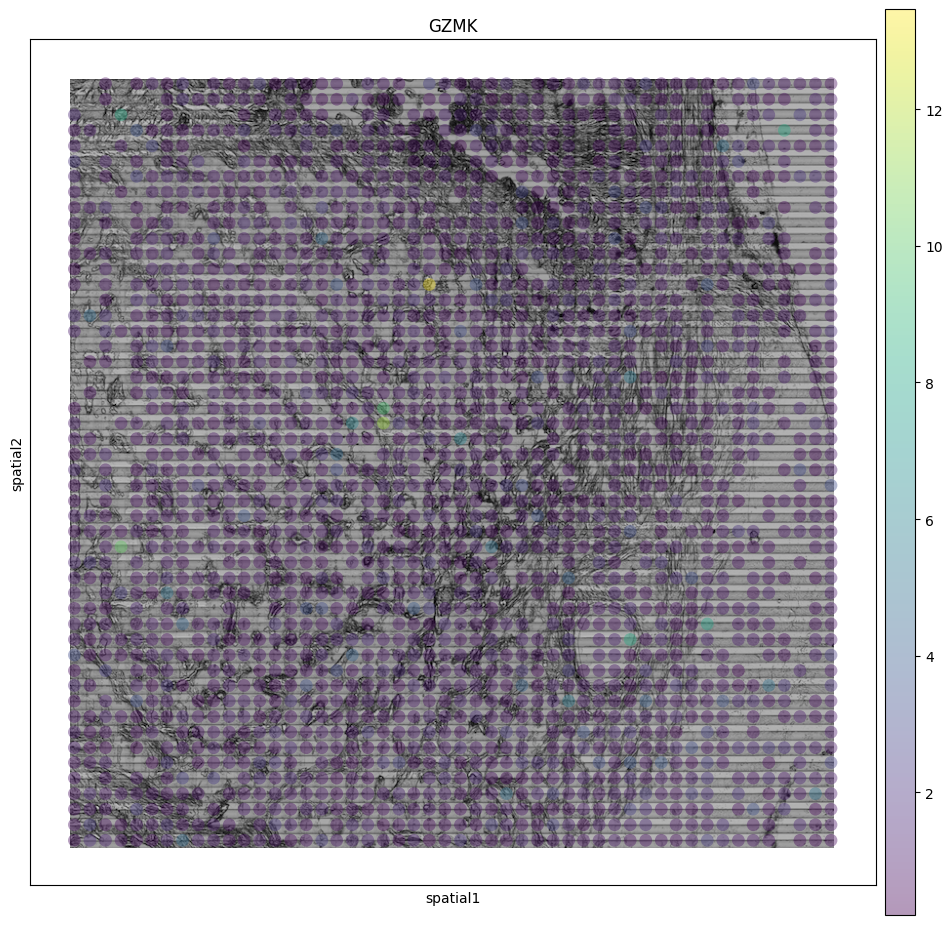

In [37]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 
sc.pl.spatial(adatam, img_key="lowres", color=["GZMK"], spot_size=18, alpha=0.4)

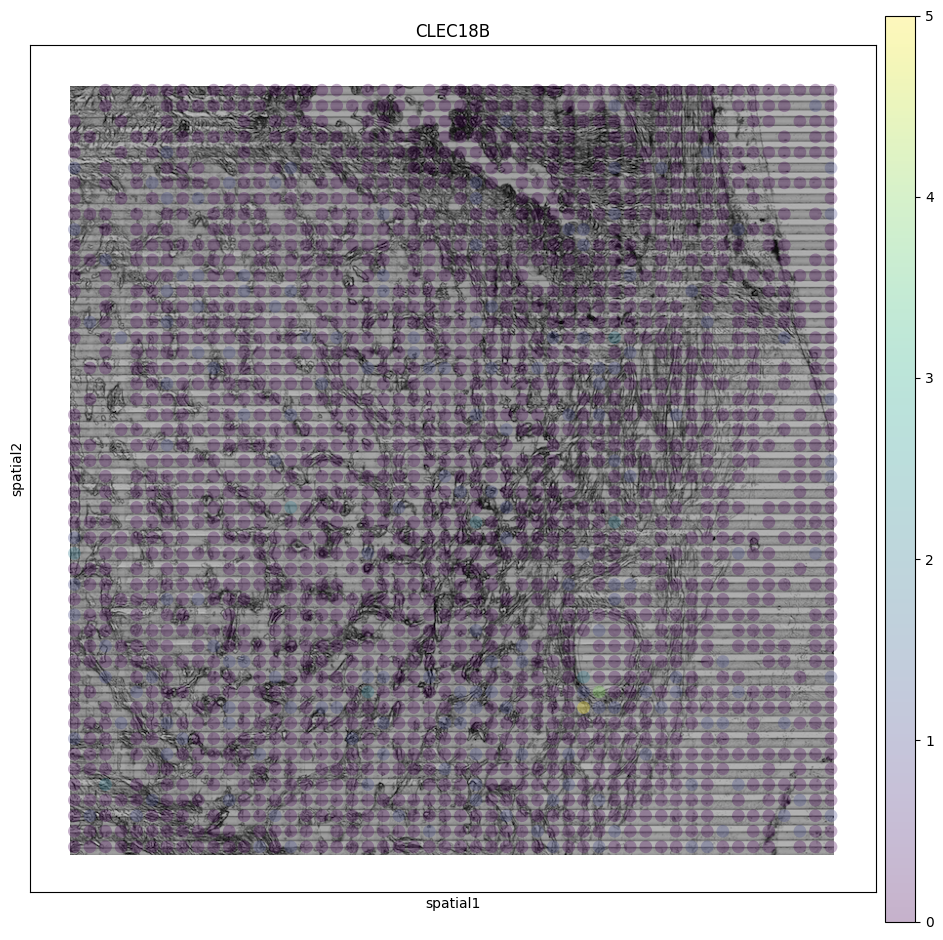

In [22]:
sc.pl.spatial(adata, img_key="lowres", color=["CLEC18B"], spot_size=18, alpha=0.3)

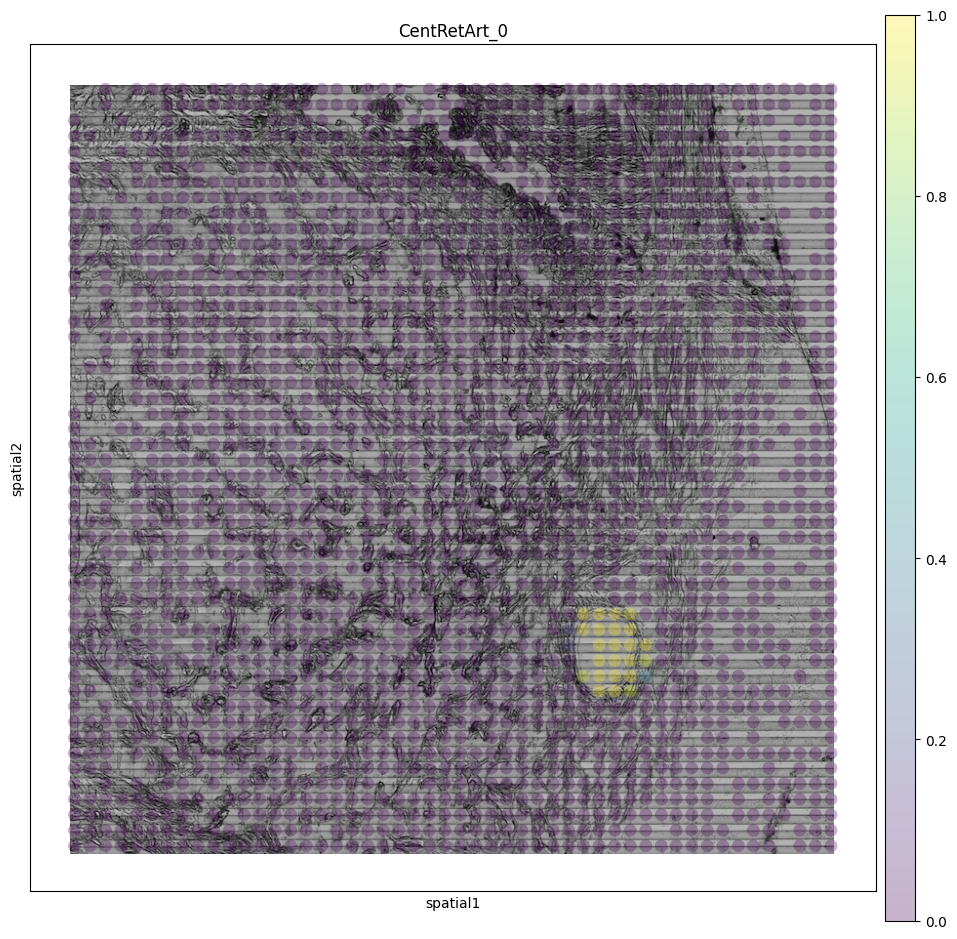

In [23]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 
sc.pl.spatial(adata, img_key="lowres", color=['CentRetArt_0'], spot_size=18, alpha=0.3)

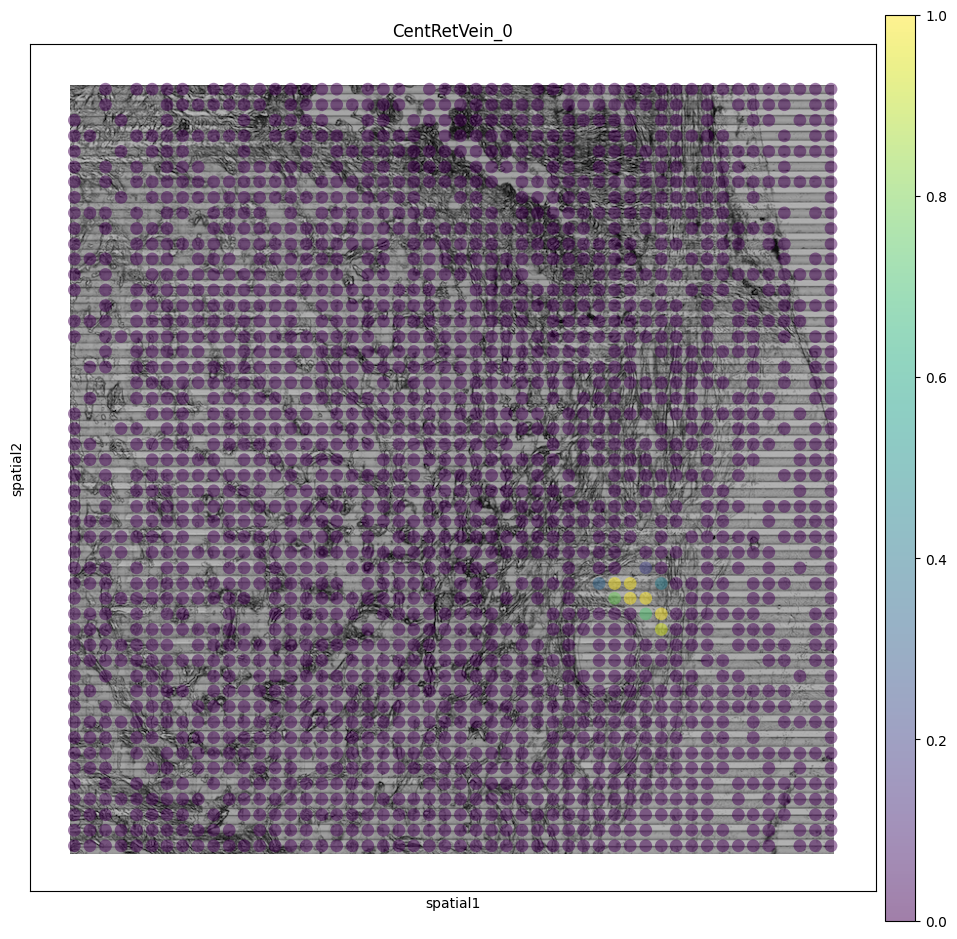

In [24]:
sc.pl.spatial(adata, img_key="lowres", color=['CentRetVein_0'], spot_size=18, alpha=0.5)

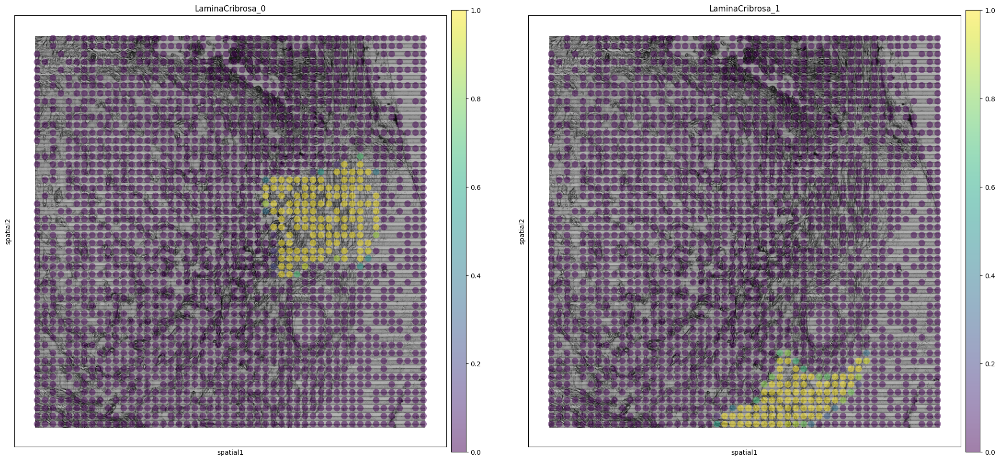

In [25]:
sc.pl.spatial(adata, img_key="lowres", color=['LaminaCribrosa_0','LaminaCribrosa_1'], spot_size=18, alpha=0.5)

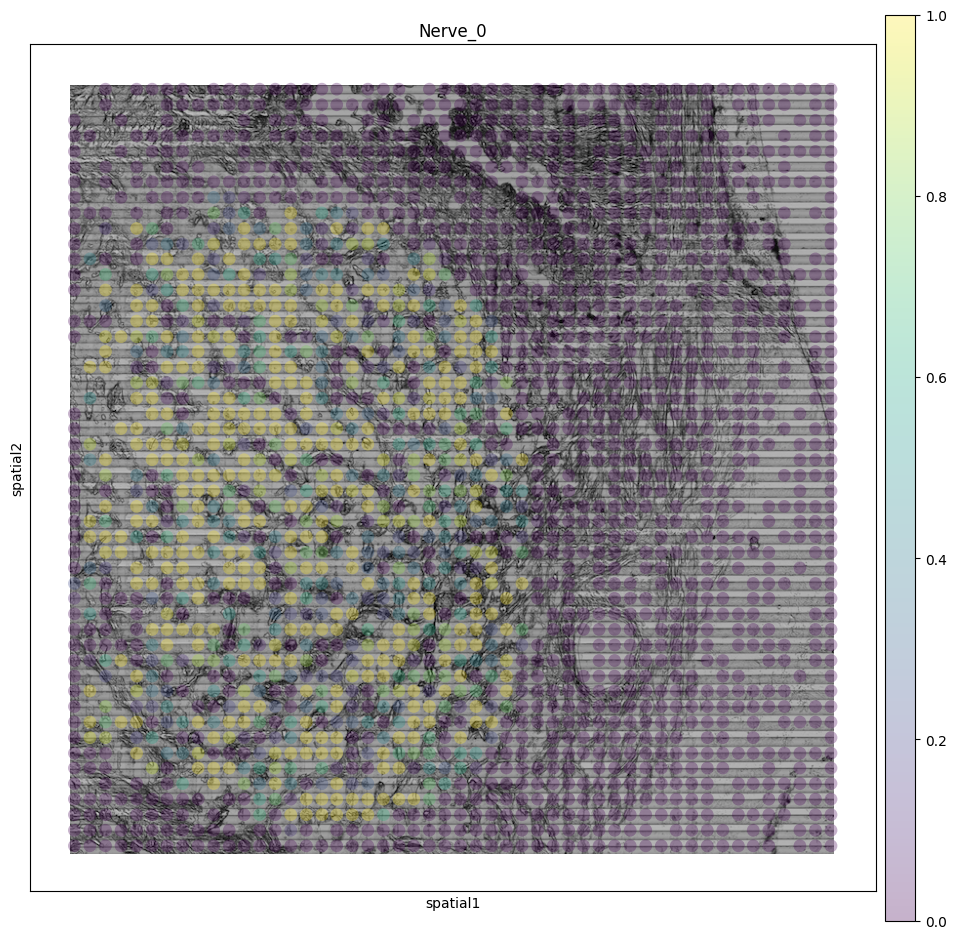

In [26]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 

sc.pl.spatial(adata, img_key="lowres", color=['Nerve_0'], spot_size=18, alpha=0.3)

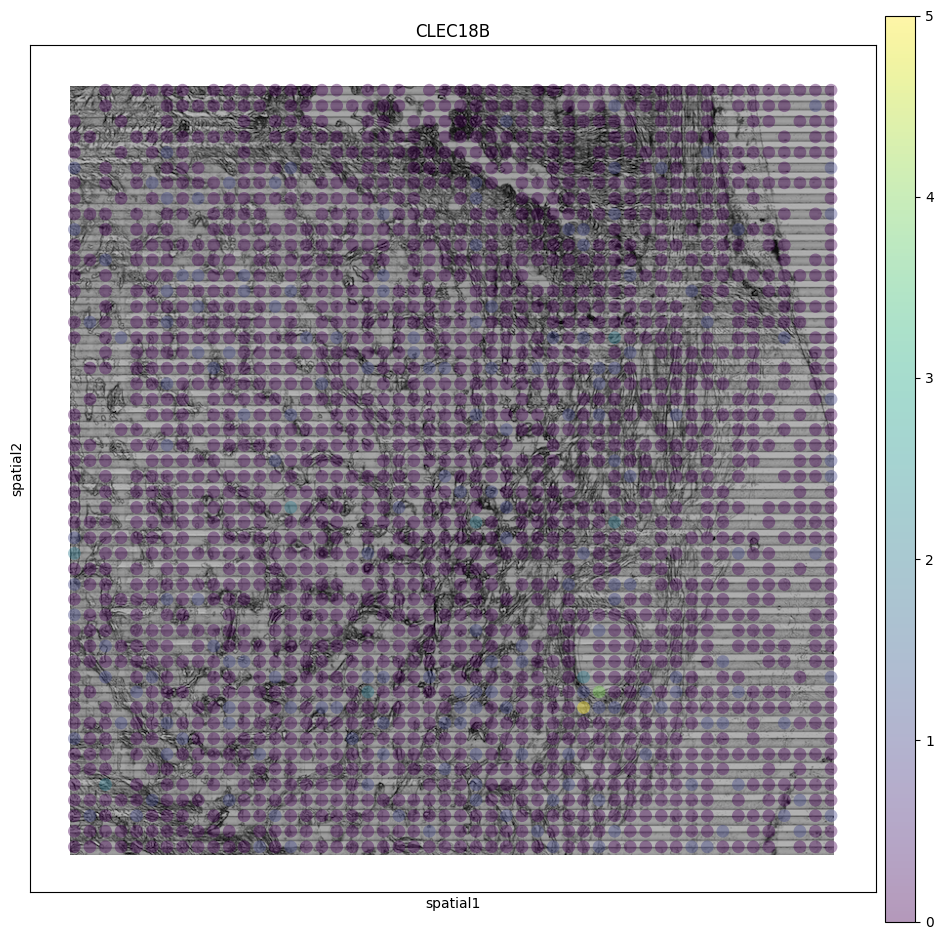

In [27]:
sc.pl.spatial(adata, img_key="lowres", color=["CLEC18B"], spot_size=18, alpha=0.4)

In [28]:
def normexprdensity(adata, genelist, regionname):
    if regionname in adata.obs_keys():
        spotdiam = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['spot_diameter_real_um']
        
        total_expression = adata[:,genelist].to_df().multiply(adata.obs[regionname], axis="index").sum()
        total_area = sum(adata.obs[regionname] * np.square(spotdiam)) 
        
        return (np.float32(total_expression/total_area)[0])

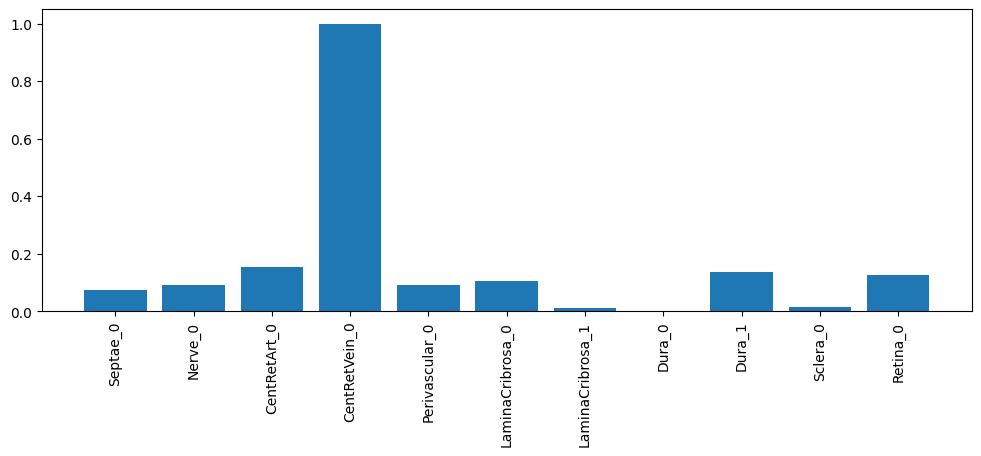

In [29]:
GENE_TO_PLOT = 'RNF213'   
    
Labels = []    
Values = []
for region in ['Septae_0',
 'Nerve_0',
 'CentRetArt_0',
 'CentRetVein_0',
 'Perivascular_0',
 'LaminaCribrosa_0',
 'LaminaCribrosa_1',
 'Dura_0',
 'Dura_1',
 'Sclera_0',
 'Retina_0',] :
        nd = normexprdensity(adata, [GENE_TO_PLOT], region)*100000
        Labels.append(region)
        Values.append(nd)

    
Values = (Values - np.min(Values))/(np.max(Values) - np.min(Values))
plt.rcParams['figure.figsize'] = [12, 4]
plt.rcParams['figure.dpi'] = 100 
plt.bar(np.arange(0,len(Labels),1), height=Values, tick_label=Labels)
plt.xticks(rotation='vertical')    
plt.show()

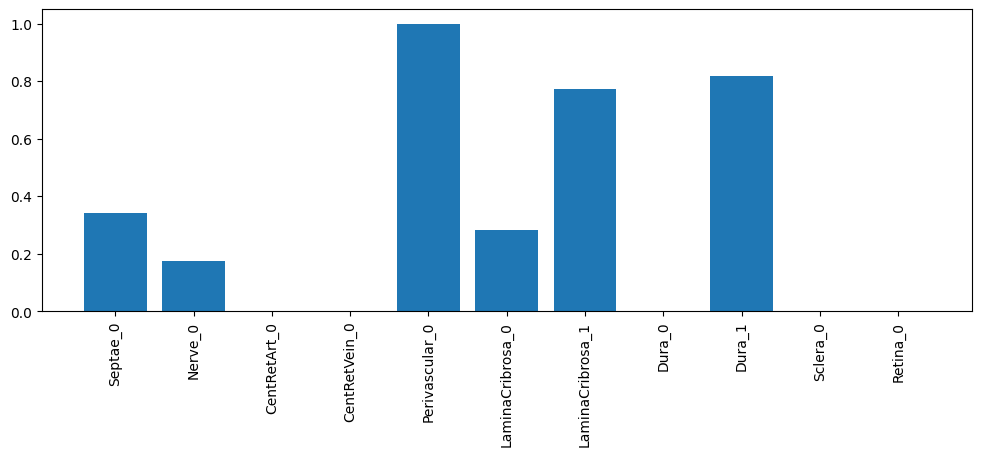

In [33]:
GENE_TO_PLOT = 'GZMK'   
    
Labels = []    
Values = []
for region in ['Septae_0',
 'Nerve_0',
 'CentRetArt_0',
 'CentRetVein_0',
 'Perivascular_0',
 'LaminaCribrosa_0',
 'LaminaCribrosa_1',
 'Dura_0',
 'Dura_1',
 'Sclera_0',
 'Retina_0',] :
        nd = normexprdensity(adata, [GENE_TO_PLOT], region)*100000
        Labels.append(region)
        Values.append(nd)

    
Values = (Values - np.min(Values))/(np.max(Values) - np.min(Values))
plt.rcParams['figure.figsize'] = [12, 4]
plt.rcParams['figure.dpi'] = 100 
plt.bar(np.arange(0,len(Labels),1), height=Values, tick_label=Labels)
plt.xticks(rotation='vertical')    
plt.show()

In [31]:
adata[adata.obs.query('n_counts > 20 and n_counts < 10 and n_genes_by_counts > 20').index]

View of AnnData object with n_obs × n_vars = 0 × 4033
    obs: 'Septae_0', 'Nerve_0', 'CentRetArt_0', 'CentRetVein_0', 'Perivascular_0', 'LaminaCribrosa_0', 'LaminaCribrosa_1', 'Dura_0', 'Dura_1', 'Sclera_0', 'Retina_0', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'n_counts'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial'